In [1]:
# !pip install "/kaggle/input/read-dicom-set/python_gdcm-3.0.22-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl" 
# !pip install "/kaggle/input/read-dicom-set/pydicom-2.4.2-py3-none-any.whl" 
# !pip install "/kaggle/input/read-dicom-set/pylibjpeg-1.4.0-py3-none-any.whl"

In [2]:
# ! pip install -U pylibjpeg pylibjpeg-openjpeg pylibjpeg-libjpeg pydicom python-gdcm
# ! pip install --upgrade pydicom

In [23]:
# import libraries for .nii and .dcm files
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns

from IPython.display import HTML

import pydicom
import os
from glob import glob
from tqdm.notebook import tqdm
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [4]:
data_dir = "S:/Capston/data"
SAVE_FOLDER = "S:/_tmp/"

In [5]:
train_images = glob(os.path.join(data_dir, 'train_images', '*/*'))

In [6]:
# train_images = [path.replace("\\", "/") for path in train_images]

In [7]:
train_images

['S:/Capston/data\\train_images\\10004\\21057',
 'S:/Capston/data\\train_images\\10004\\51033',
 'S:/Capston/data\\train_images\\10005\\18667',
 'S:/Capston/data\\train_images\\10007\\47578',
 'S:/Capston/data\\train_images\\10026\\29700',
 'S:/Capston/data\\train_images\\10026\\42932',
 'S:/Capston/data\\train_images\\10051\\17486',
 'S:/Capston/data\\train_images\\10051\\50172',
 'S:/Capston/data\\train_images\\10065\\37324',
 'S:/Capston/data\\train_images\\10065\\46839',
 'S:/Capston/data\\train_images\\10082\\8139',
 'S:/Capston/data\\train_images\\10104\\27573',
 'S:/Capston/data\\train_images\\10105\\42418',
 'S:/Capston/data\\train_images\\10124\\58500',
 'S:/Capston/data\\train_images\\10127\\1554',
 'S:/Capston/data\\train_images\\10127\\53380',
 'S:/Capston/data\\train_images\\10132\\4816',
 'S:/Capston/data\\train_images\\10163\\17557',
 'S:/Capston/data\\train_images\\10169\\18334',
 'S:/Capston/data\\train_images\\10172\\50253',
 'S:/Capston/data\\train_images\\10205\\652

In [8]:
os.path.join(data_dir,'train.csv')

'S:/Capston/data\\train.csv'

In [9]:
train_df = pd.read_csv(os.path.join(data_dir,'train.csv'))
train_df.head()
train_df.shape

(3147, 15)

In [10]:
series_meta_df = pd.read_csv(os.path.join(data_dir,'train_series_meta.csv'))

In [11]:
image_labels_df = pd.read_csv(os.path.join(data_dir,'image_level_labels.csv'))

In [12]:
series_meta_df.shape

(4711, 4)

In [13]:
series_meta_df.head(3)

,patient_id,series_id,aortic_hu,incomplete_organ
0,10004,21057,146.00,0
1,10004,51033,454.75,0
2,10005,18667,187.00,0


In [14]:
series_meta_df['series_id'].nunique()

4711

In [15]:
train_df['patient_id'].nunique()

3147

checking to see the distibution of Injury

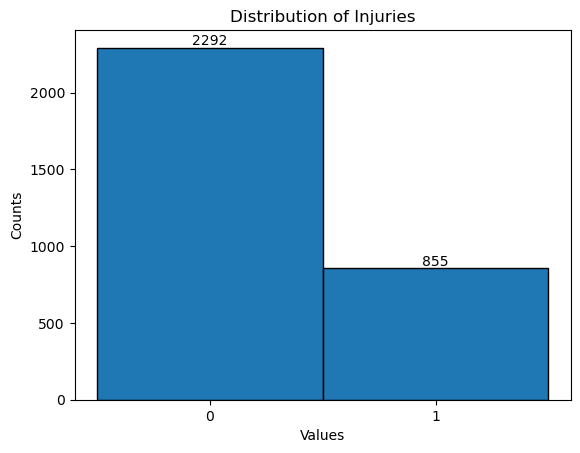

In [16]:
from collections import Counter
# Count the occurrence of each value
counts = Counter(train_df.iloc[:, -1])
# Make the histogram using plt.hist, bins must be integer
plt.hist(train_df.iloc[:, -1], bins=[-0.5, 0.5, 1.5], edgecolor='black')

plt.title('Distribution of Injuries')
plt.xlabel('Values')
plt.ylabel('Counts')

# Display counts above bars
for x, y in counts.items():
    plt.text(x, y, str(y), ha='center', va='bottom')

plt.xticks([0, 1])
plt.show()

In [17]:
image_labels_df.shape

(12029, 4)

In [18]:
image_labels_df['injury_name'].value_counts()

injury_name
Active_Extravasation    6370
Bowel                   5659
Name: count, dtype: int64

In [19]:
image_labels_df['patient_id'].nunique()

246

In [20]:
image_labels_df.head(2)

,patient_id,series_id,instance_number,injury_name
0,10004,21057,362,Active_Extravasation
1,10004,21057,363,Active_Extravasation


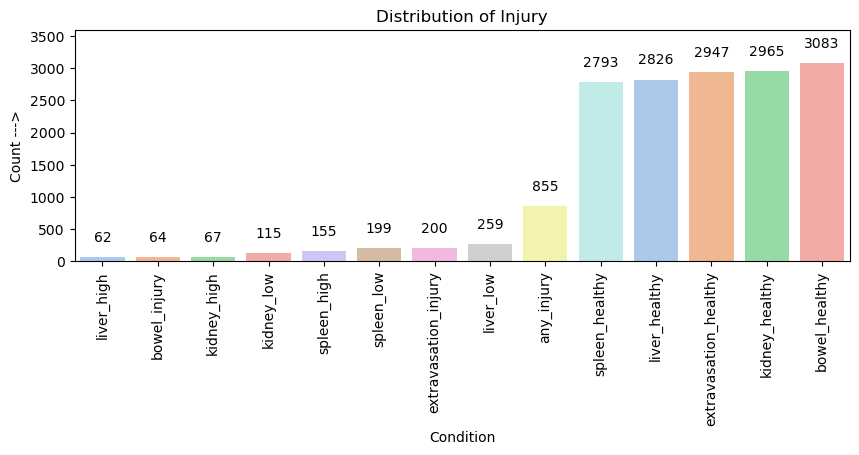

In [21]:
organ_columns = ['bowel', 'extravasation', 'kidney', 'liver', 'spleen']

   
organ_counts = pd.DataFrame({
    'Organ': train_df.columns[1:],
    'count': [train_df[column].sum() for column in train_df.columns[1:]]
})

plt.figure(figsize=(10, 3))
palette = sns.color_palette("pastel", len(organ_counts['Organ'].unique()))
ax = sns.barplot(data=organ_counts.sort_values(by='count'), x='Organ', y='count', palette=palette, hue="Organ")
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'bottom', 
                xytext = (0, 9), 
                textcoords = 'offset points')
plt.xticks(rotation=90)
plt.title("Distribution of Injury")
plt.xlabel("Condition")
plt.ylim((0,3600))
plt.ylabel("Count --->")
plt.show()

Animation size has reached 21122714 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


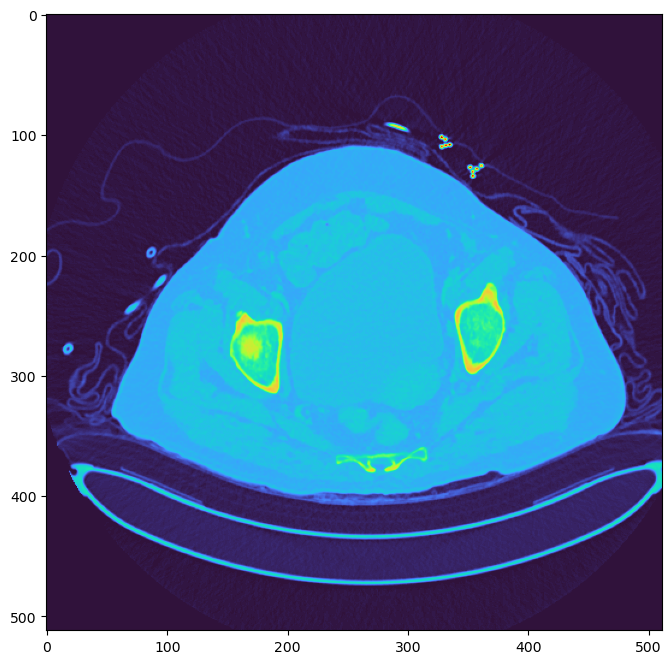

In [25]:
file_1 = [os.path.join(data_dir,'train_images/10004/21057/') + file
         for file in os.listdir(os.path.join(data_dir,'train_images/10004/21057'))]
file_2 = [os.path.join(data_dir,'train_images/10004/51033/') + file
         for file in os.listdir(os.path.join(data_dir,'train_images/10004/51033'))]
# Read the dcm files and extract the pixel arrays
dcmis = [pydicom.dcmread(f).pixel_array for f in file_1]

# Create a figure and axis for plotting
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the first frame and keep the plot object for later
im = ax.imshow(dcmis[0], cmap=plt.cm.turbo)

# Create the animation
amn = animation.FuncAnimation(fig, lambda i : im.set_array(dcmis[i]), frames=range(len(dcmis)), repeat=True, repeat_delay=50000)

# Demonstrate the animation
HTML(amn.to_jshtml())